<a href="https://colab.research.google.com/github/umiSirya/CreditCard-Expenditure-India/blob/main/spendingIndia.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# Importing necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import geopandas as gpd
import pyogrio



In [ ]:
# get geojson url
url = "https://gist.githubusercontent.com/rupinder-developer/9cf97efbbd9651eef88729fb390485c1/raw/d1f9b712521271747d26c6524e93afbe2a8562df/indian-cities.geojson"
gdf = gpd.read_file(url) # load geojson data
gdf.head()

,id,name,geometry
0,Papum Pare,Papum Pare,"POLYGON ((94.21135 27.49735, 94.08565 27.40535..."
1,Tawang,Tawang,"POLYGON ((92.31713 27.7791, 92.27036 27.65835,..."
2,Tirap,Tirap,"POLYGON ((95.63787 27.23572, 95.6554 27.13222,..."
3,Upper Dibang Valley,Upper Dibang Valley,"POLYGON ((96.36866 28.56397, 96.15235 28.65597..."
4,Upper Siang,Upper Siang,"POLYGON ((95.27247 29.05847, 95.24324 28.98947..."


In [ ]:
path = '/content/Credit card transactions - India - Simple.csv'
credit = pd.read_csv(path)
credit

,index,City,Date,Card Type,Exp Type,Gender,Amount
0,0,"Delhi, India",29-Oct-14,Gold,Bills,F,82475
1,1,"Greater Mumbai, India",22-Aug-14,Platinum,Bills,F,32555
2,2,"Bengaluru, India",27-Aug-14,Silver,Bills,F,101738
3,3,"Greater Mumbai, India",12-Apr-14,Signature,Bills,F,123424
4,4,"Bengaluru, India",5-May-15,Gold,Bills,F,171574
...,...,...,...,...,...,...,...
26047,26047,"Kolkata, India",22-Jun-14,Silver,Travel,F,128191
26048,26048,"Pune, India",3-Aug-14,Signature,Travel,M,246316
26049,26049,"Hyderabad, India",16-Jan-15,Silver,Travel,M,265019
26050,26050,"Kanpur, India",14-Sep-14,Silver,Travel,M,88174


In [ ]:
# Remove ", India" from the City column
credit["City"] = credit["City"].str.replace(", India", "", regex=False)
credit.head()

,index,City,Date,Card Type,Exp Type,Gender,Amount
0,0,Delhi,29-Oct-14,Gold,Bills,F,82475
1,1,Greater Mumbai,22-Aug-14,Platinum,Bills,F,32555
2,2,Bengaluru,27-Aug-14,Silver,Bills,F,101738
3,3,Greater Mumbai,12-Apr-14,Signature,Bills,F,123424
4,4,Bengaluru,5-May-15,Gold,Bills,F,171574


In [ ]:
india = credit.merge(gdf, how='inner', right_on='name', left_on='City')
india

,index,City,Date,Card Type,Exp Type,Gender,Amount,id,name,geometry
0,0,Delhi,29-Oct-14,Gold,Bills,F,82475,Delhi,Delhi,"POLYGON ((77.18673 28.86584, 77.21596 28.83422..."
1,5,Delhi,8-Sep-14,Silver,Bills,F,100036,Delhi,Delhi,"POLYGON ((77.18673 28.86584, 77.21596 28.83422..."
2,6,Delhi,24-Feb-15,Gold,Bills,F,143250,Delhi,Delhi,"POLYGON ((77.18673 28.86584, 77.21596 28.83422..."
3,8,Delhi,28-Mar-14,Silver,Bills,F,192247,Delhi,Delhi,"POLYGON ((77.18673 28.86584, 77.21596 28.83422..."
4,9,Delhi,1-Sep-14,Platinum,Bills,F,67932,Delhi,Delhi,"POLYGON ((77.18673 28.86584, 77.21596 28.83422..."
...,...,...,...,...,...,...,...,...,...,...
11184,26047,Kolkata,22-Jun-14,Silver,Travel,F,128191,Kolkata,Kolkata,"POLYGON ((88.40591 22.55523, 88.36498 22.49485..."
11185,26048,Pune,3-Aug-14,Signature,Travel,M,246316,Pune,Pune,"POLYGON ((74.83941 18.33761, 74.85111 18.30024..."
11186,26049,Hyderabad,16-Jan-15,Silver,Travel,M,265019,Hyderabad,Hyderabad,"POLYGON ((78.50509 17.44924, 78.53432 17.45786..."
11187,26050,Kanpur,14-Sep-14,Silver,Travel,M,88174,Kanpur,Kanpur,"POLYGON ((80.55716 26.23235, 80.53378 26.2036,..."


In [ ]:
india.columns

Index(['index', 'City', 'Date', 'Card Type', 'Exp Type', 'Gender', 'Amount',
       'id', 'name', 'geometry'],
      dtype='object')

In [ ]:
columnsTodrop=['id','name']
india.drop(columns=columnsTodrop, inplace=True)
india.head()

,index,City,Date,Card Type,Exp Type,Gender,Amount,geometry
0,0,Delhi,29-Oct-14,Gold,Bills,F,82475,"POLYGON ((77.18673 28.86584, 77.21596 28.83422..."
1,5,Delhi,8-Sep-14,Silver,Bills,F,100036,"POLYGON ((77.18673 28.86584, 77.21596 28.83422..."
2,6,Delhi,24-Feb-15,Gold,Bills,F,143250,"POLYGON ((77.18673 28.86584, 77.21596 28.83422..."
3,8,Delhi,28-Mar-14,Silver,Bills,F,192247,"POLYGON ((77.18673 28.86584, 77.21596 28.83422..."
4,9,Delhi,1-Sep-14,Platinum,Bills,F,67932,"POLYGON ((77.18673 28.86584, 77.21596 28.83422..."


**Convert india(Dataframe) into a geopandas Dataframe**

In [ ]:
india = gpd.GeoDataFrame(india, geometry=india['geometry'], crs="EPSG:4326")
print(type(india))


<class 'geopandas.geodataframe.GeoDataFrame'>


In [ ]:

#Ensure CRS is WGS84 for compatibility with Plotly
india = india.to_crs(epsg=4326)

# Convert GeoDataFrame to GeoJSON
geojson_data = india.__geo_interface__

# Create choropleth map using Plotly
fig = px.choropleth_mapbox(
    india,
    geojson=geojson_data,
    locations=india.index,  # Use the GeoDataFrame's index for matching
    color="Amount",  # Color intensity based on transaction amounts
    hover_name="City",  # Display city names on hover
    hover_data={"City": True, "Amount": True},  # Specify which columns to show on hover
    title="Transaction Amounts by City",
    mapbox_style="carto-positron",
    center={"lat": 20.5937, "lon": 78.9629},  # Center map over India
    zoom=4,  # Set an appropriate zoom level
    color_continuous_scale="Viridis",  # Apply visually pleasing color scale
)

# Show the map
fig.show()


# **Exploratory Data Analysis**

<Axes: >

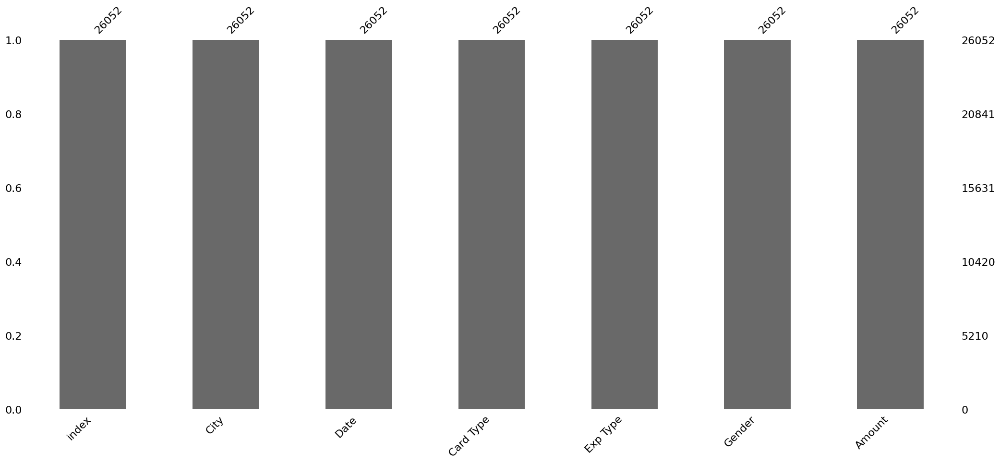

In [ ]:
import missingno as msno
msno.bar(credit)

In [ ]:
credit.columns

Index(['index', 'City', 'Date', 'Card Type', 'Exp Type', 'Gender', 'Amount'], dtype='object')

In [ ]:
credit.isnull().sum()

,0
index,0
City,0
Date,0
Card Type,0
Exp Type,0
Gender,0
Amount,0


In [ ]:
credit.duplicated().sum()

0

In [ ]:
credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26052 entries, 0 to 26051
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   index      26052 non-null  int64 
 1   City       26052 non-null  object
 2   Date       26052 non-null  object
 3   Card Type  26052 non-null  object
 4   Exp Type   26052 non-null  object
 5   Gender     26052 non-null  object
 6   Amount     26052 non-null  int64 
dtypes: int64(2), object(5)
memory usage: 1.4+ MB


# **Data Cleaning**

**Drop index column**

In [ ]:
#drop the index column(dont need it)
credit.drop('index',axis=1,inplace=True)
credit.head()

,City,Date,Card Type,Exp Type,Gender,Amount
0,Delhi,29-Oct-14,Gold,Bills,F,82475
1,Greater Mumbai,22-Aug-14,Platinum,Bills,F,32555
2,Bengaluru,27-Aug-14,Silver,Bills,F,101738
3,Greater Mumbai,12-Apr-14,Signature,Bills,F,123424
4,Bengaluru,5-May-15,Gold,Bills,F,171574


**Change date column to dtype datetime**





In [ ]:
# chang date column from oject dtype to datetime
credit['Date'] = pd.to_datetime(credit['Date'], format='%d-%b-%y')
credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 26052 entries, 0 to 26051
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype         
---  ------     --------------  -----         
 0   City       26052 non-null  object        
 1   Date       26052 non-null  datetime64[ns]
 2   Card Type  26052 non-null  object        
 3   Exp Type   26052 non-null  object        
 4   Gender     26052 non-null  object        
 5   Amount     26052 non-null  int64         
dtypes: datetime64[ns](1), int64(1), object(4)
memory usage: 1.2+ MB


**Create Year column with corresponding year to Date column**

In [ ]:
# Ensure Date column is in datetime format
credit["Date"] = pd.to_datetime(credit["Date"])

# Extract the year and create a new column
credit["Year"] = credit["Date"].dt.year

# **Data Visualisation**

**Card Type Usage Distribution**

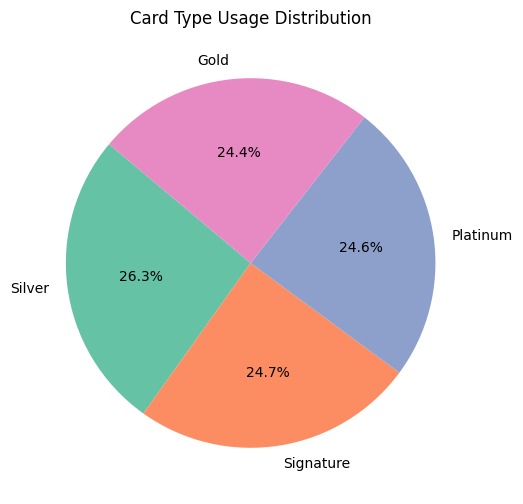

In [ ]:
card_usage = credit['Card Type'].value_counts()

plt.figure(figsize=(8, 6))
card_usage.plot(kind='pie', autopct='%1.1f%%', startangle=140, colors=sns.color_palette('Set2'))
plt.title('Card Type Usage Distribution')
plt.ylabel('')
plt.show()

**Top 10 cities by Expenditure(General)**


In [ ]:
# Group data by 'City', sum the 'Amount', and sort in descending order
city_exp = credit.groupby('City')['Amount'].sum().sort_values(ascending=False).head(10).reset_index()

# Create the bar chart using Plotly
fig = px.bar(
    city_exp,
    x='City',
    y='Amount',
    title='Top 10 Cities by Total Expenditure',
    labels={'Amount': 'Total Expenditure', 'City': 'City'}
)

# Update layout for vertical x-axis labels
fig.update_layout(
    xaxis_title="City",
    yaxis_title="Total Expenditure",
    xaxis_tickangle=90,  # Set x-axis labels to vertical
    title_x=0.5  # Center the title
)

# Show the figure
fig.show()


**Expenditure trend over the years( 2013-2015)**

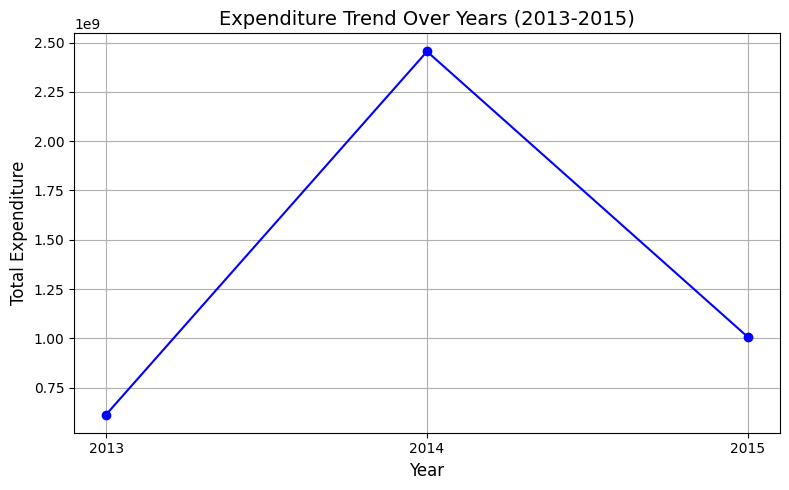

In [ ]:
# Aggregate data by year
expenditure_by_year = credit.groupby("Year")["Amount"].sum()

# Plot the trend
plt.figure(figsize=(8, 5))
plt.plot(expenditure_by_year.index, expenditure_by_year.values, marker="o", linestyle="-", color="b")
plt.title("Expenditure Trend Over Years (2013-2015)", fontsize=14)
plt.xlabel("Year", fontsize=12)
plt.ylabel("Total Expenditure", fontsize=12)
plt.grid(True)
plt.xticks(expenditure_by_year.index)
plt.tight_layout()

# Display the plot
plt.show()

In [ ]:
# Aggregate data by year
expenditure_by_year = credit.groupby("Year")["Amount"].sum().reset_index()

# Plot using Plotly
fig = px.line(
    expenditure_by_year,
    x="Year",
    y="Amount",
    title="Expenditure Trend Over Years (2013-2015)",
    labels={"Year": "Year", "Amount": "Total Expenditure"},
    markers=True
)

fig.update_layout(
    title_font_size=18,
    xaxis_title="Year",
    yaxis_title="Total Expenditure",
    template="plotly_white"
)

fig.show()

**Gender- Wise Expenditure in 2014**

In [ ]:
# Filter the data for the year 2014
filtered_credit = credit[credit['Year'] == 2014]

# Group data by 'Gender' and sum the 'Amount'
gender_exp = filtered_credit.groupby('Gender')['Amount'].sum().reset_index()

# Create the bar chart using Plotly
fig = px.bar(
    gender_exp,
    x='Gender',
    y='Amount',
    title='Gender-wise Expenditure (Year 2014)',
    labels={'Amount': 'Total Expenditure', 'Gender': 'Gender'},
    color='Gender',  # Optional: Adds color differentiation by Gender
    color_discrete_map={'M': 'blue', 'F': 'pink'}  # Specify custom colors
)

# Update layout for better formatting
fig.update_layout(
    xaxis_title="Gender",
    yaxis_title="Total Expenditure",
    title_x=0.5,  # Center the title
    xaxis_tickangle=0  # Keep x-axis labels horizontal
)

# Show the figure
fig.show()


**Expense type by Gender in 2014**

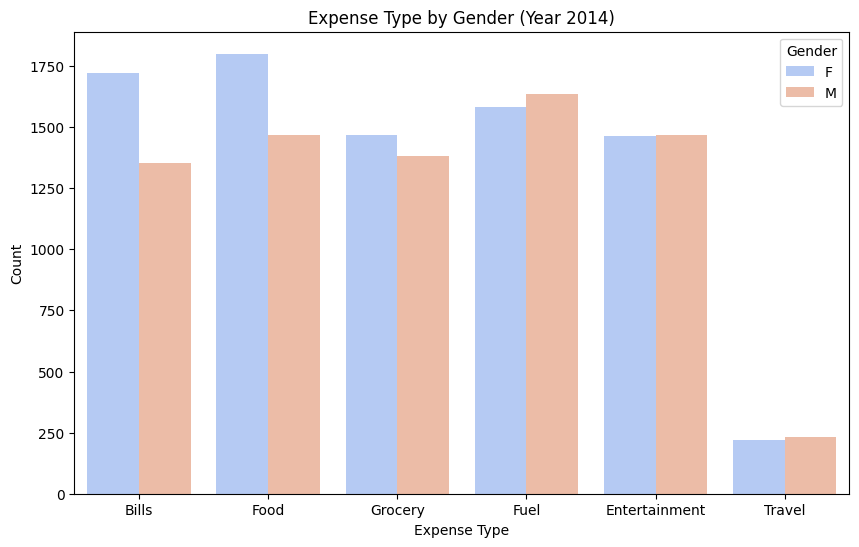

In [ ]:
# Filter to include only rows where Year is 2014
filtered_df = credit[credit['Year'] == 2014]

# Create the plot
plt.figure(figsize=(10, 6))
sns.countplot(data=filtered_df, x='Exp Type', hue='Gender', palette='coolwarm')
plt.title('Expense Type by Gender (Year 2014)')
plt.xlabel('Expense Type')
plt.ylabel('Count')
plt.legend(title='Gender')
plt.show()

**Top 10 cities by expenditure(Year 2014)**

In [ ]:
# Filter the data for the year 2014
filtered_credit = credit[credit['Year'] == 2014]

# Group data by 'City', sum the 'Amount', and sort in descending order
city_exp = filtered_credit.groupby('City')['Amount'].sum().sort_values(ascending=False).head(10).reset_index()

# Create the bar chart using Plotly
fig = px.bar(
    city_exp,
    x='City',
    y='Amount',
    title='Top 10 Cities by Total Expenditure (Year 2014)',
    labels={'Amount': 'Total Expenditure', 'City': 'City'}
)

# Update layout for vertical x-axis labels
fig.update_layout(
    xaxis_title="City",
    yaxis_title="Total Expenditure",
    xaxis_tickangle=90,  # Set x-axis labels to vertical
    title_x=0.5  # Center the title
)

# Show the figure
fig.show()